In [1]:
import yfinance as yf
from finta import TA
import seaborn as sns
import pandas as pd
import plotly.graph_objects as go
import numpy as np
import yahoo_fin.stock_info as si
import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.cluster import DBSCAN

from collections import OrderedDict
import pandas as pd
from functools import reduce
import random

import warnings
warnings.filterwarnings("ignore")

In [2]:
def impute_values(df):
    # Fill NA's with previous 
    df = df.fillna(method='ffill')

#     df['Close'] = df.Close.interpolate()
#     df['High'] = df.High.interpolate()
#     df['Open'] = df.Open.interpolate()
#     df['Low'] = df.Low.interpolate()
    return df


def compute_indicators(df,indicators):
    """
    Function to compute indicators. You could add more indicators.
    """

    indicators_names = []

    if indicators.get("KAMA",[]):
        kama = indicators.get("KAMA")

        for k in kama:
            kama_values = TA.KAMA(df,k).tolist()

            col = "kama_{}".format(str(k))
            df[col] = kama_values

            indicators_names.append(col)

    return df,indicators_names


def compute_floors_ceilings(data,g_value,l_value):
    # Compute floors and ceilings
    g_value = "kama_{}".format(g_value)
    l_value = "kama_{}".format(l_value)
  
    data['floor_ceil'] = [1 if row[g_value] <= row[l_value] else -1 
                                for ind, row in data[[g_value,l_value]].iterrows()]

    floor_ceil = data.floor_ceil.tolist()

    val_min = [np.inf,""]
    val_max = [-np.inf,""]
    all_values = []
  
    for ind,_ in enumerate(floor_ceil):
        if ind==0:
            continue

        if floor_ceil[ind]==floor_ceil[ind-1]:
            if floor_ceil[ind] == 1:
                if val_max[0] < data.loc[ind,"High"]:
                    val_max[0] = data.loc[ind,"High"]
                    val_max[1] = data.loc[ind,"Date"]
            else:
                if val_min[0] > data.loc[ind,"Low"]:
                    val_min[0] = data.loc[ind,"Low"]
                    val_min[1] = data.loc[ind,"Date"]
        else:
            all_values.append(val_max)
            all_values.append(val_min)

            val_min = [np.inf,""]
            val_max = [-np.inf,""]
      
    floor_ceil = pd.DataFrame(all_values)

    if floor_ceil.empty:
        return floor_ceil
    else:
        floor_ceil.columns = ['value','dates']
        floor_ceil = floor_ceil[~floor_ceil.dates.isna()]
        
    ini_lines = floor_ceil.shape[0]
    floor_ceil['value_st'] = (floor_ceil.value - floor_ceil.value.min())/\
                                (floor_ceil.value.max() - floor_ceil.value.min()) 
    floor_ceil['value_st_2'] = 1#floor_ceil.value_st
    
    # Select eps value
    dist_eu = euclidean_distances(floor_ceil[['value_st','value_st_2']])
    vals = [np.round(e,3) for e in list(dist_eu.flatten()) if e > 0]
    e = np.percentile(vals,5)

    db = DBSCAN(eps=e, min_samples=2).fit(floor_ceil[['value_st','value_st_2']])
    floor_ceil['classification'] = db.labels_

    df_class = floor_ceil[floor_ceil.classification!=-1]\
                        .groupby('classification')\
                        .agg({'value':'mean',
                              'dates':'first'}).reset_index()
    
    df_without_class = floor_ceil.loc[floor_ceil.classification==-1,
                                      ['classification','value','dates']]
    
    floor_ceil = pd.concat([df_without_class,
                            df_class])
    
    print("ratio lines: ", 100*floor_ceil.shape[0]/ini_lines)
          
    return floor_ceil

def compute_var(df):
    df = df.sort_values('Date')
    df['profit'] = df.sort_values('Date').Close.diff().divide(df.sort_values('Date').Close)
    
    var_per_1 = np.percentile(df.profit.dropna().round(4).array,1)
    var_per_5 = np.percentile(df.profit.dropna().round(4).array,5)

    close_values = df.Close.tolist()

    func = lambda x: df.Close.diff(x).tolist()[-1]
    
    prof_5_days = func(4)/close_values[-5]
    prof_30_days = func(29)/close_values[-30]
    prof_260_days = func(259)/close_values[-260]

    df['week'],df['weekday'],df['year'] = zip(*df.Date.map(lambda x: [x.week,x.weekday(),x.year]))
    weekly = df.loc[df.groupby(['year','week'])['weekday']
                      .agg(['idxmax','idxmin']).melt()['value']]\
                .sort_values('Date')
    
    weekly_profit = weekly.sort_values(['Date']).groupby(['year','week'])\
                          .apply(lambda x: x.Close.diff().divide(x.Close.values[0]))\
                          .reset_index().dropna() 
    

    var_per_week_1 = np.percentile(weekly_profit.Close.round(4).array,1)
    var_per_week_5 = np.percentile(weekly_profit.Close.round(4).array,5)
  
    val = OrderedDict()
  
    val["var_per_1"] = var_per_1
    val["var_per_5"] = var_per_5
    val["prof_5_days"] = prof_5_days
    val["prof_30_days"] = prof_30_days
    val["prof_260_days"] = prof_260_days 
    val["var_per_week_1"] = var_per_week_1
    val["var_per_week_5"] = var_per_week_5
  
    return val

def compute_increase(df,tk):
    df[tk] = df.sort_values('Date').Close.diff()>0
    return df[['Date',tk]]


def plot_tickers(data,cost_in,ticker,floor_ceil,start='2020-12-01',end='2021-12-01',l_value=5,g_value=10):
    # Get data from start to end dates
    data = data[(data.Date>=start)&(data.Date<=end)]
  
    # Plot data
    fig = go.Figure(data=[go.Candlestick(x=data['Date'],
                                    open=data['Open'],
                                    high=data['High'],
                                    low=data['Low'],
                                    close=data['Close']),
                     go.Scatter(x=data['Date'], y=data['kama_{}'.format(g_value)], line=dict(color='orange', width=2)),
                     go.Scatter(x=data['Date'], y=data['kama_{}'.format(l_value)], line=dict(color='blue', width=2))])

    fig.update_layout(xaxis_rangeslider_visible=False)
    fig.update_layout(
       title="Analysis",
       yaxis_title="{} Stock".format(ticker))
  #     shapes = [dict(
  #         x0='2020-03-18', x1='2020-03-18', y0=0, y1=1, xref='x', yref='paper',
  #         line_width=2)],
  #     annotations=[dict(
  #         x='2020-03-18', y=0.05, xref='x', yref='paper',
  #         showarrow=False, xanchor='left', text='Covid')]
  # )
    for row in floor_ceil.iterrows():
        fig.add_shape(type="line", x0 = start,
                                 y0 = row[1]['value'],
                                 x1 = data.Date.max(),
                                 y1 = row[1]['value'], fillcolor = 'yellow')
    if cost_in!= 0:
        fig.add_shape(type="line", x0 = start,
                              y0 = cost_in,
                              x1 = data.Date.max(),
                              y1 = cost_in, line_color = 'red',line_dash="dash")
  
    fig.show()


In [3]:
tickers = pd.read_csv("stocks.csv")['Stocks'].tolist()

In [4]:
# Today date
today = pd.to_datetime("today").date().strftime("%Y-%m-%d")

indicators = {"KAMA":[3,10]}

data = yf.download(" ".join(tickers), start="2020-01-01", end=today)

[*********************100%***********************]  62 of 62 completed

1 Failed download:
- HERO.MX: No data found for this date range, symbol may be delisted


In [5]:
no_data_tickers = []
values = {}
first_tick = tickers[0]

for tk in tickers:
    print(tk)
    
    # Get OCHL
    open = data["Open"][tk].rename("Open").reset_index()
    close = data["Close"][tk].rename("Close").reset_index()
    high = data["High"][tk].rename("High").reset_index()
    low = data["Low"][tk].rename("Low").reset_index()
  
    func = lambda x,y: x.merge(y,on='Date',how='left')
  
    # Merge all dataframes
    df = reduce(func,[open,close,high,low])
    
    # Impute values
    df = impute_values(df)

    # Compute indicators
    df,cols = compute_indicators(df,indicators)
  
    # Compute ceiling and floor
    try:
        l_value = min(indicators["KAMA"])
        g_value = max(indicators["KAMA"])
        floor_ceil = compute_floors_ceilings(df,g_value,l_value)
    except:
        no_data_tickers.append(tk)
        continue

    # Compute VaR
    try:
        var = compute_var(df)
        values[tk] = var
    except:
        continue   
    
    # Compute increase/decrease
    df_aux = compute_increase(df,tk)
    
    if first_tick == tk:
        df_increase = df_aux.copy()
    else:
        df_increase = df_increase.merge(df_aux,on=['Date'],how='outer')
        
    cost_in = []

    if len(cost_in)>0:
        cost_in = cost_in[0]
    else:
        cost_in = 0
  
    plot_tickers(df,cost_in,tk,floor_ceil,start='2020-01-01',end=today,l_value=l_value,g_value=g_value)

^VIX
ratio lines:  34.883720930232556


AAPL.MX
ratio lines:  42.857142857142854


AGUA.MX
ratio lines:  45.45454545454545


ALFAA.MX
ratio lines:  40.0


ALPEKA.MX
ratio lines:  34.09090909090909


ALSEA.MX
ratio lines:  36.58536585365854


AMD.MX
ratio lines:  40.0


AMXL.MX
ratio lines:  42.22222222222222


BABAN.MX
ratio lines:  42.42424242424242


BAC.MX
ratio lines:  35.8974358974359


BACHOCOB.MX
ratio lines:  34.09090909090909


BBVA.MX
ratio lines:  46.875


BIMBOA.MX
ratio lines:  52.77777777777778


BOTZ
ratio lines:  43.58974358974359


CEMEXCPO.MX
ratio lines:  30.952380952380953


CUERVO.MX
ratio lines:  41.02564102564103


DANHOS13.MX
ratio lines:  46.15384615384615


FCX.MX
ratio lines:  42.42424242424242


FEMSAUBD.MX
ratio lines:  42.857142857142854


FIBRAMQ12.MX
ratio lines:  51.42857142857143


GAPB.MX
ratio lines:  32.6530612244898


GCARSOA1.MX
ratio lines:  46.15384615384615


GENIUS21.MX
ratio lines:  65.21739130434783


GFINBURO.MX
ratio lines:  51.351351351351354


GFNORTEO.MX
ratio lines:  38.888888888888886


HCITY.MX
ratio lines:  35.294117647058826


HERDEZ.MX
ratio lines:  36.170212765957444


HERO
ratio lines:  37.5


HERO.MX
INTC.MX
ratio lines:  39.130434782608695


IVVPESOISHRS.MX
ratio lines:  100.0


KIMBERA.MX
ratio lines:  41.86046511627907


KO.MX
ratio lines:  40.42553191489362


LACOMERUBC.MX
ratio lines:  38.095238095238095


LIVEPOLC-1.MX
ratio lines:  43.333333333333336


MCHI.MX
ratio lines:  100.0


MEDICAB.MX
ratio lines:  50.0


NAFTRAC.MX
ratio lines:  38.23529411764706


NEMAKA.MX
ratio lines:  40.0


NIO
ratio lines:  41.30434782608695


NKLA.MX
ratio lines:  70.0


NVDA.MX
ratio lines:  38.46153846153846


ORBIA.MX
ratio lines:  55.172413793103445


PE&OLES.MX
ratio lines:  50.0


Q.MX
ratio lines:  42.857142857142854


SBUX.MX
ratio lines:  41.02564102564103


SITESB-1.MX
ratio lines:  41.1764705882353


SLV.MX
ratio lines:  39.02439024390244


SORIANAB.MX
ratio lines:  47.36842105263158


SPCE.MX
ratio lines:  50.0


T.MX
ratio lines:  50.0


TCEHYN.MX
ratio lines:  45.45454545454545


TLEVISACPO.MX
ratio lines:  36.36363636363637


TSMN.MX
UBER.MX
ratio lines:  36.36363636363637


VESTA.MX
ratio lines:  45.714285714285715


VGT
ratio lines:  42.42424242424242


VGT.MX
ratio lines:  75.0


VOLARA.MX
ratio lines:  29.166666666666668


VOO
ratio lines:  51.351351351351354


VOO.MX
ratio lines:  52.0


WALMEX.MX
ratio lines:  27.083333333333332


In [6]:
df['aniomes'] = df.Date.map(lambda x: str(x.year)) + df.Date.map(lambda x: str(x.month).zfill(2))#.profit.plot.kde()

In [7]:
#aux = df_increase.set_index('Date')
aux2 = []
for tk in tickers:
    try:
        aux = df_increase.set_index('Date').copy()
        aux = aux[['AMD.MX',tk]].join(aux[['AMD.MX',tk]].apply(lambda x: pd.Series([x[0] & x[1],~x[0] & ~x[1],~x[0] & x[1],x[0] & ~x[1]],
                                             index=['both_increase','both_decrease','first_decrease','second_decrease']),axis=1))
        summary_df = aux[['both_increase','both_decrease','first_decrease','second_decrease']]\
                        .mean().rename(tk).reset_index().set_index('index').T.copy()
        aux2.append(summary_df)
    except:
        pass

In [8]:
f = pd.concat(aux2)
f['follow_direction'] = f.both_increase + f.both_decrease

In [9]:
l = df_increase.loc[df_increase['AAPL.MX']].shape[0]
(df_increase.loc[df_increase['AAPL.MX'],['NVDA.MX','AMD.MX']].apply(lambda x: x[0] & x[1],axis=1).sum())/l

0.6164383561643836

In [10]:
df_increase[['NVDA.MX','AMD.MX']].apply(lambda x: x[0] & x[1],axis=1).mean()

0.40365448504983387

In [11]:
0.61*0.5/0.4

0.7625

In [12]:
f.sort_values('follow_direction')

index,both_increase,both_decrease,first_decrease,second_decrease,follow_direction
^VIX,0.139535,0.227575,0.290698,0.342193,0.367110
MEDICAB.MX,0.146179,0.347176,0.171096,0.335548,0.493355
KIMBERA.MX,0.224252,0.275748,0.242525,0.257475,0.500000
GFNORTEO.MX,0.249169,0.252492,0.265781,0.232558,0.501661
WALMEX.MX,0.239203,0.262458,0.255814,0.242525,0.501661
T.MX,0.214286,0.294020,0.224252,0.267442,0.508306
LIVEPOLC-1.MX,0.237542,0.272425,0.245847,0.244186,0.509967
ALSEA.MX,0.240864,0.272425,0.245847,0.240864,0.513289
KO.MX,0.239203,0.274086,0.244186,0.242525,0.513289
GCARSOA1.MX,0.245847,0.272425,0.245847,0.235880,0.518272


In [13]:
func = lambda x: 100*(x.Close.tolist()[1] -  x.Close.tolist()[0])/x.Close.tolist()[0]
aux = df.loc[df.groupby(['aniomes'])['Date'].agg(['idxmax','idxmin']).melt()['value']].sort_values('Date').groupby('aniomes').apply(lambda x: func(x))
aux#.plot()

aniomes
202001     0.181427
202002    -0.036220
202003    -3.077191
202004     3.333338
202005    -4.519584
202006    -2.337524
202007    -6.364287
202008    -2.559824
202009    -0.075345
202010    -2.917221
202011     3.902439
202012     1.449799
202101     1.974829
202102     2.279352
202103     6.491576
202104     2.854035
202105    -0.713528
202106     0.030740
202107     2.243693
202108     7.200713
202109    -1.627162
202110     2.351759
202111    -8.114011
202112     9.293297
202201    -5.190597
202202     8.465611
202203     6.652781
202204   -10.371380
dtype: float64

In [14]:
risk_df = pd.DataFrame.from_dict({k:list(values[k].values()) for k in values.keys()}, orient='index')
risk_df.columns = ['risk_1','risk_5','profit_5','profit_30','profit_260','risk_s_1','risk_s_5']
100*risk_df.sort_values('profit_260')

,risk_1,risk_5,profit_5,profit_30,profit_260,risk_s_1,risk_s_5
SPCE.MX,-17.1900,-8.7760,-8.438541,-19.295573,-65.935527,-26.3871,-16.9675
NIO,-13.5100,-7.7200,-3.523967,-19.942472,-58.082328,-20.3993,-15.9550
BABAN.MX,-7.8100,-4.5600,15.017598,-10.303452,-57.685154,-14.5379,-10.7680
TCEHYN.MX,-8.4900,-5.0400,3.023256,-13.441908,-44.968944,-9.6622,-6.7560
CEMEXCPO.MX,-7.4600,-4.9100,0.898876,-16.928777,-44.188941,-13.1870,-7.9875
UBER.MX,-7.2340,-4.7185,-0.611621,-4.220207,-41.121587,-15.8560,-9.0760
T.MX,-5.0300,-2.6500,-1.354329,-18.552886,-39.321260,-6.5907,-4.7605
MCHI.MX,-4.6500,-3.0600,7.929841,-8.312732,-37.787907,-6.9835,-5.9015
HCITY.MX,-7.5300,-4.2500,-0.200005,-2.918290,-35.278862,-17.8697,-11.6990
SBUX.MX,-5.5100,-3.0700,-2.337150,-15.310019,-33.682073,-6.7007,-5.4580


(-50.0, 50.0)

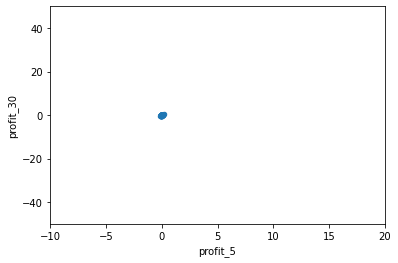

In [15]:
risk_df.plot.scatter(x='profit_5',y='profit_30')
plt.xlim([-10,20])
plt.ylim([-50,50])

In [16]:
tikers_info = {}
for tk in tickers:
    tikers_info[tk] = si.get_quote_table(tk)

IndexError: list index out of range

In [ ]:
df = pd.DataFrame(columns=["tk","pe","eps"])

for tk in tikers_info.keys():
    new_row = {}
    try:
        new_row["tk"] = tk
        new_row["pe"] = tikers_info[tk]['PE Ratio (TTM)']
        new_row["eps"] = tikers_info[tk]['EPS (TTM)']

        df = df.append(new_row,ignore_index=True)
    except:
        print(tk)